In [1]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
loan_url ="https://raw.githubusercontent.com/jagielski/manip-ml/master/datasets/loan-processed.csv"
loan_data=pd.read_csv(loan_url)
print(loan_data.shape)
loan_data.head()


(168048, 89)


,int_rate,loan_amnt,annual_inc,dti,delinq_2yrs,inq_last_6mths,pub_rec,open_acc,pub_rec.1,revol_bal,...,addr_state:UT,addr_state:MO,addr_state:MN,addr_state:MI,addr_state:KS,addr_state:MT,addr_state:MS,addr_state:SC,addr_state:KY,addr_state:OR
0,0.225180,0.130435,0.002106,0.691423,0.0,0.030303,0.0,0.024096,0.0,0.005330,...,0,0,0,0,0,0,0,0,0,0
1,0.420363,0.057971,0.002738,0.025006,0.0,0.151515,0.0,0.024096,0.0,0.000659,...,0,0,0,0,0,0,0,0,0,0
2,0.562738,0.072464,0.004634,0.133783,0.0,0.060606,0.0,0.036145,0.0,0.003210,...,0,0,0,0,0,0,0,0,0,0
3,0.394170,0.173913,0.007161,0.403101,0.0,0.060606,0.0,0.156627,0.0,0.001575,...,0,0,0,0,0,0,0,0,0,0
4,0.029996,0.089855,0.011163,0.263066,0.0,0.000000,0.0,0.228916,0.0,0.008918,...,0,0,0,0,0,0,0,0,0,0


In [3]:
loan_data.describe()

,int_rate,loan_amnt,annual_inc,dti,delinq_2yrs,inq_last_6mths,pub_rec,open_acc,pub_rec.1,revol_bal,...,addr_state:UT,addr_state:MO,addr_state:MN,addr_state:MI,addr_state:KS,addr_state:MT,addr_state:MS,addr_state:SC,addr_state:KY,addr_state:OR
count,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,...,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000
mean,0.334385,0.418465,0.007621,0.451803,0.016737,0.020939,0.000354,0.127693,0.187411,0.006695,...,0.007069,0.016114,0.018239,0.024993,0.008884,0.002940,0.004035,0.012169,0.009723,0.012473
std,0.185749,0.245074,0.006908,0.206154,0.045424,0.030278,0.001061,0.064063,0.561084,0.008814,...,0.083782,0.125916,0.133814,0.156104,0.093838,0.054139,0.063390,0.109641,0.098127,0.110983
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.197296,0.228986,0.004528,0.297574,0.000000,0.000000,0.000000,0.084337,0.000000,0.002557,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.324039,0.370290,0.006424,0.440610,0.000000,0.000000,0.000000,0.120482,0.000000,0.004709,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.459654,0.565217,0.009056,0.595399,0.000000,0.030303,0.000000,0.156627,0.000000,0.008238,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.043478,1.000000,23.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [4]:
uniqueValues = loan_data.nunique()

In [5]:
pd.set_option("display.max_rows", None, "display.max_columns", None)
print(uniqueValues)

int_rate                              507
loan_amnt                            1347
annual_inc                          12651
dti                                  3996
delinq_2yrs                            20
inq_last_6mths                         19
pub_rec                                22
open_acc                               58
pub_rec.1                              22
revol_bal                           44996
revol_util                           1142
total_acc                             113
collections_12_mths_ex_med              6
acc_now_delinq                          6
emp_length                             10
earliest_cr_line                       63
mths_since_last_delinq                118
mths_since_last_record                121
mths_since_last_major_derog           157
home_ownership:NONE                     2
home_ownership:OWN                      2
home_ownership:OTHER                    2
home_ownership:RENT                     2
verification_status:Not Verified  

In [6]:
for i in range(len(loan_data)):
    if loan_data["addr_state:WA"][i]==1:
        loan_data["addr_state:WA"][i]=1  
    elif loan_data["addr_state:ND"][i]==1:
        loan_data["addr_state:ND"][i]=2
    elif loan_data["addr_state:DE"][i]==1:
        loan_data["addr_state:DE"][i]=3
    elif loan_data["addr_state:DC"][i]==1:
        loan_data["addr_state:DC"][i]=4
    elif loan_data["addr_state:WI"][i]==1:
        loan_data["addr_state:WI"][i]=5
    elif loan_data["addr_state:WV"][i]==1:
        loan_data["addr_state:WV"][i]=6
    elif loan_data["addr_state:HI"][i]==1:
        loan_data["addr_state:HI"][i]=7
    elif loan_data["addr_state:FL"][i]==1:
        loan_data["addr_state:FL"][i]=8
    elif loan_data["addr_state:WY"][i]==1:
        loan_data["addr_state:WY"][i]=9
    elif loan_data["addr_state:NH"][i]==1:
        loan_data["addr_state:NH"][i]=10
    elif loan_data["addr_state:NJ"][i]==1:
        loan_data["addr_state:NJ"][i]=11
    elif loan_data["addr_state:NM"][i]==1:
        loan_data["addr_state:NM"][i]=12
    elif loan_data["addr_state:TX"][i]==1:
        loan_data["addr_state:TX"][i]=13
    elif loan_data["addr_state:LA"][i]==1:
        loan_data["addr_state:LA"][i]=14
    elif loan_data["addr_state:NC"][i]==1:
        loan_data["addr_state:NC"][i]=15
    elif loan_data["addr_state:AK"][i]==1:
        loan_data["addr_state:AK"][i]=16
    elif loan_data["addr_state:NE"][i]==1:
        loan_data["addr_state:NE"][i]=17
    elif loan_data["addr_state:TN"][i]==1:
        loan_data["addr_state:TN"][i]=18
    elif loan_data["addr_state:NY"][i]==1:
        loan_data["addr_state:NY"][i]=19
    elif loan_data["addr_state:PA"][i]==1:
        loan_data["addr_state:PA"][i]=20
    elif loan_data["addr_state:RI"][i]==1:
        loan_data["addr_state:RI"][i]=21
    elif loan_data["addr_state:NV"][i]==1:
        loan_data["addr_state:NV"][i]=22
    elif loan_data["addr_state:VA"][i]==1:
        loan_data["addr_state:VA"][i]=23
    elif loan_data["addr_state:CO"][i]==1:
        loan_data["addr_state:CO"][i]=24
    elif loan_data["addr_state:CA"][i]==1:
        loan_data["addr_state:CA"][i]=25
    elif loan_data["addr_state:AL"][i]==1:
        loan_data["addr_state:AL"][i]=26
    elif loan_data["addr_state:AR"][i]==1:
        loan_data["addr_state:AR"][i]=27
    elif loan_data["addr_state:VT"][i]==1:
        loan_data["addr_state:VT"][i]=28
    elif loan_data["addr_state:IL"][i]==1:
        loan_data["addr_state:IL"][i]=29
    elif loan_data["addr_state:GA"][i]==1:
        loan_data["addr_state:GA"][i]=30
    elif loan_data["addr_state:IN"][i]==1:
        loan_data["addr_state:IN"][i]=31
    elif loan_data["addr_state:IA"][i]==1:
        loan_data["addr_state:IA"][i]=32
    elif loan_data["addr_state:MA"][i]==1:
        loan_data["addr_state:MA"][i]=33
    elif loan_data["addr_state:AZ"][i]==1:
        loan_data["addr_state:AZ"][i]=34
    elif loan_data["addr_state:ID"][i]==1:
        loan_data["addr_state:ID"][i]=35
    elif loan_data["addr_state:CT"][i]==1:
        loan_data["addr_state:CT"][i]=36
    elif loan_data["addr_state:ME"][i]==1:
        loan_data["addr_state:ME"][i]=37
    elif loan_data["addr_state:MD"][i]==1:
        loan_data["addr_state:MD"][i]=38
    elif loan_data["addr_state:OK"][i]==1:
        loan_data["addr_state:OK"][i]=39
    elif loan_data["addr_state:OH"][i]==1:
        loan_data["addr_state:OH"][i]=40
    elif loan_data["addr_state:UT"][i]==1:
        loan_data["addr_state:UT"][i]=41
    elif loan_data["addr_state:MO"][i]==1:
        loan_data["addr_state:MO"][i]=42
    elif loan_data["addr_state:MN"][i]==1:
        loan_data["addr_state:MN"][i]=43
    elif loan_data["addr_state:MI"][i]==1:
        loan_data["addr_state:MI"][i]=44
    elif loan_data["addr_state:KS"][i]==1:
        loan_data["addr_state:KS"][i]=45
    elif loan_data["addr_state:MT"][i]==1:
        loan_data["addr_state:MT"][i]=46
    elif loan_data["addr_state:MS"][i]==1:
        loan_data["addr_state:MS"][i]=47
    elif loan_data["addr_state:SC"][i]==1:
        loan_data["addr_state:SC"][i]=48
    elif loan_data["addr_state:KY"][i]==1:
        loan_data["addr_state:KY"][i]=49
    else:
#         loan_data["addr_state:OR"][i]==1:
        loan_data["addr_state:OR"][i]=50

   

<ipython-input-6-ba37d1ea12c5>:69: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loan_data["addr_state:AZ"][i]=34
<ipython-input-6-ba37d1ea12c5>:61: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loan_data["addr_state:GA"][i]=30
<ipython-input-6-ba37d1ea12c5>:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loan_data["addr_state:CA"][i]=25
<ipython-input-6-ba37d1ea12c5>:73: SettingWithCopyWarning: 
A value is trying to be set on a copy

<ipython-input-6-ba37d1ea12c5>:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loan_data["addr_state:AL"][i]=26
<ipython-input-6-ba37d1ea12c5>:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loan_data["addr_state:VT"][i]=28
<ipython-input-6-ba37d1ea12c5>:91: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loan_data["addr_state:KS"][i]=45
<ipython-input-6-ba37d1ea12c5>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy

In [7]:
loan_data.describe()

,int_rate,loan_amnt,annual_inc,dti,delinq_2yrs,inq_last_6mths,pub_rec,open_acc,pub_rec.1,revol_bal,revol_util,total_acc,collections_12_mths_ex_med,acc_now_delinq,emp_length,earliest_cr_line,mths_since_last_delinq,mths_since_last_record,mths_since_last_major_derog,home_ownership:NONE,home_ownership:OWN,home_ownership:OTHER,home_ownership:RENT,verification_status:Not Verified,verification_status:Verified,purpose:debt_consolidation,purpose:renewable_energy,purpose:car,purpose:medical,purpose:wedding,purpose:vacation,purpose:credit_card,purpose:educational,purpose:other,purpose:moving,purpose:house,purpose:small_business,purpose:major_purchase,term: 36 months,addr_state:WA,addr_state:ND,addr_state:DE,addr_state:DC,addr_state:WI,addr_state:WV,addr_state:HI,addr_state:FL,addr_state:WY,addr_state:NH,addr_state:NJ,addr_state:NM,addr_state:TX,addr_state:LA,addr_state:NC,addr_state:AK,addr_state:NE,addr_state:TN,addr_state:NY,addr_state:PA,addr_state:RI,addr_state:NV,addr_state:VA,addr_state:CO,addr_state:CA,addr_state:AL,addr_state:AR,addr_state:VT,addr_state:IL,addr_state:GA,addr_state:IN,addr_state:IA,addr_state:MA,addr_state:AZ,addr_state:ID,addr_state:CT,addr_state:ME,addr_state:MD,addr_state:OK,addr_state:OH,addr_state:UT,addr_state:MO,addr_state:MN,addr_state:MI,addr_state:KS,addr_state:MT,addr_state:MS,addr_state:SC,addr_state:KY,addr_state:OR
count,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.00000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000
mean,0.334385,0.418465,0.007621,0.451803,0.016737,0.020939,0.000354,0.127693,0.187411,0.006695,0.150843,0.144760,0.002827,0.000987,0.566068,0.793108,0.616151,0.938311,0.818838,0.000036,0.093967,0.000196,0.404236,0.310792,0.307311,0.594360,0.000613,0.010128,0.009646,0.002553,0.005368,0.230178,0.000452,0.047010,0.006076,0.004296,0.012062,0.019721,0.693486,0.021857,0.001035,0.008016,0.010711,0.064208,0.030527,0.036698,0.542559,0.021958,0.049331,0.408586,0.068123,1.055484,0.168785,0.414792,0.040274,0.022053,0.255356,1.579828,0.706584,0.094473,0.295082,0.69254,0.509569,3.660859,0.323051,0.203085,0.059983,1.167089,0.994716,0.479994,0.000381,0.795308,0.760735,0.000208,0.567266,0.023779,0.886866,0.360879,1.311292,0.289846,0.676807,0.784270,1.099686,0.399796,0.135223,0.189624,0.584119,0.476447,0.730744
std,0.185749,0.245074,0.006908,0.206154,0.045424,0.030278,0.001061,0.064063,0.561084,0.008814,0.064877,0.070534,0.025666,0.015218,0.393346,0.105737,0.405068,0.173303,0.323628,0.005975,0.291784,0.014012,0.490745,0.462819,0.461381,0.491017,0.024750,0.100128,0.097740,0.050461,0.073067,0.420948,0.021261,0.211662,0.077710,0.065406,0.109163,0.139039,0.461047,0.146216,0.045495,0.154863,0.206713,0.562955,0.426885,0.505509,2.011499,0.444006,0.700629,2.080271,0.901579,3.550679,1.527913,2.459648,0.801729,0.611899,2.128667,5.246050,3.692221,1.405354,2.530766,3.93051,3.459777,8.838555,2

In [8]:
column_list = list(loan_data)
l=list(loan_data)
for i in range (0,39):
    s =l[i]
    column_list.remove(s)

print(column_list)

loan_data["addr_state"] = loan_data[column_list].sum(axis=1)
loan_data["addr_state"]

['addr_state:WA', 'addr_state:ND', 'addr_state:DE', 'addr_state:DC', 'addr_state:WI', 'addr_state:WV', 'addr_state:HI', 'addr_state:FL', 'addr_state:WY', 'addr_state:NH', 'addr_state:NJ', 'addr_state:NM', 'addr_state:TX', 'addr_state:LA', 'addr_state:NC', 'addr_state:AK', 'addr_state:NE', 'addr_state:TN', 'addr_state:NY', 'addr_state:PA', 'addr_state:RI', 'addr_state:NV', 'addr_state:VA', 'addr_state:CO', 'addr_state:CA', 'addr_state:AL', 'addr_state:AR', 'addr_state:VT', 'addr_state:IL', 'addr_state:GA', 'addr_state:IN', 'addr_state:IA', 'addr_state:MA', 'addr_state:AZ', 'addr_state:ID', 'addr_state:CT', 'addr_state:ME', 'addr_state:MD', 'addr_state:OK', 'addr_state:OH', 'addr_state:UT', 'addr_state:MO', 'addr_state:MN', 'addr_state:MI', 'addr_state:KS', 'addr_state:MT', 'addr_state:MS', 'addr_state:SC', 'addr_state:KY', 'addr_state:OR']


0         34
1         30
2         25
3         34
4         36
5         41
6         25
7         29
8          8
9         11
10        21
11        25
12        13
13        13
14        13
15        40
16        25
17         8
18        30
19        25
20        13
21        29
22        11
23        25
24        11
25        25
26        25
27        30
28        29
29        25
30        50
31        30
32         8
33        29
34        23
35         1
36        19
37        25
38        38
39         8
40        34
41        30
42        13
43        50
44        13
45        40
46        46
47         5
48        38
49         8
50         8
51        22
52        20
53        19
54        50
55        25
56        30
57        48
58         9
59        38
60         8
61         8
62        29
63        42
64         8
65         7
66         8
67        25
68        25
69        20
70         8
71        40
72        23
73        42
74        25
75         5
76        11

In [9]:
loan_data.describe()

,int_rate,loan_amnt,annual_inc,dti,delinq_2yrs,inq_last_6mths,pub_rec,open_acc,pub_rec.1,revol_bal,revol_util,total_acc,collections_12_mths_ex_med,acc_now_delinq,emp_length,earliest_cr_line,mths_since_last_delinq,mths_since_last_record,mths_since_last_major_derog,home_ownership:NONE,home_ownership:OWN,home_ownership:OTHER,home_ownership:RENT,verification_status:Not Verified,verification_status:Verified,purpose:debt_consolidation,purpose:renewable_energy,purpose:car,purpose:medical,purpose:wedding,purpose:vacation,purpose:credit_card,purpose:educational,purpose:other,purpose:moving,purpose:house,purpose:small_business,purpose:major_purchase,term: 36 months,addr_state:WA,addr_state:ND,addr_state:DE,addr_state:DC,addr_state:WI,addr_state:WV,addr_state:HI,addr_state:FL,addr_state:WY,addr_state:NH,addr_state:NJ,addr_state:NM,addr_state:TX,addr_state:LA,addr_state:NC,addr_state:AK,addr_state:NE,addr_state:TN,addr_state:NY,addr_state:PA,addr_state:RI,addr_state:NV,addr_state:VA,addr_state:CO,addr_state:CA,addr_state:AL,addr_state:AR,addr_state:VT,addr_state:IL,addr_state:GA,addr_state:IN,addr_state:IA,addr_state:MA,addr_state:AZ,addr_state:ID,addr_state:CT,addr_state:ME,addr_state:MD,addr_state:OK,addr_state:OH,addr_state:UT,addr_state:MO,addr_state:MN,addr_state:MI,addr_state:KS,addr_state:MT,addr_state:MS,addr_state:SC,addr_state:KY,addr_state:OR,addr_state
count,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.00000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000
mean,0.334385,0.418465,0.007621,0.451803,0.016737,0.020939,0.000354,0.127693,0.187411,0.006695,0.150843,0.144760,0.002827,0.000987,0.566068,0.793108,0.616151,0.938311,0.818838,0.000036,0.093967,0.000196,0.404236,0.310792,0.307311,0.594360,0.000613,0.010128,0.009646,0.002553,0.005368,0.230178,0.000452,0.047010,0.006076,0.004296,0.012062,0.019721,0.693486,0.021857,0.001035,0.008016,0.010711,0.064208,0.030527,0.036698,0.542559,0.021958,0.049331,0.408586,0.068123,1.055484,0.168785,0.414792,0.040274,0.022053,0.255356,1.579828,0.706584,0.094473,0.295082,0.69254,0.509569,3.660859,0.323051,0.203085,0.059983,1.167089,0.994716,0.479994,0.000381,0.795308,0.760735,0.000208,0.567266,0.023779,0.886866,0.360879,1.311292,0.289846,0.676807,0.784270,1.099686,0.399796,0.135223,0.189624,0.584119,0.476447,0.730744,24.060483
std,0.185749,0.245074,0.006908,0.206154,0.045424,0.030278,0.001061,0.064063,0.561084,0.008814,0.064877,0.070534,0.025666,0.015218,0.393346,0.105737,0.405068,0.173303,0.323628,0.005975,0.291784,0.014012,0.490745,0.462819,0.461381,0.491017,0.024750,0.100128,0.097740,0.050461,0.073067,0.420948,0.021261,0.211662,0.077710,0.065406,0.109163,0.139039,0.461047,0.146216,0.045495,0.154863,0.206713,0.562955,0.426885,0.505509,2.011499,0.444006,0.700629,2.080271,0.901579,3.550679,1.527913,2.459648,0.801729,0.611899,2.128667,5.246050,3.692221,1.405354,2

In [10]:
loan_data["addr_state"].nunique()

50

In [11]:
loan_data.drop(column_list, axis = 1, inplace = True) 

In [12]:
loan_data.head()

,int_rate,loan_amnt,annual_inc,dti,delinq_2yrs,inq_last_6mths,pub_rec,open_acc,pub_rec.1,revol_bal,revol_util,total_acc,collections_12_mths_ex_med,acc_now_delinq,emp_length,earliest_cr_line,mths_since_last_delinq,mths_since_last_record,mths_since_last_major_derog,home_ownership:NONE,home_ownership:OWN,home_ownership:OTHER,home_ownership:RENT,verification_status:Not Verified,verification_status:Verified,purpose:debt_consolidation,purpose:renewable_energy,purpose:car,purpose:medical,purpose:wedding,purpose:vacation,purpose:credit_card,purpose:educational,purpose:other,purpose:moving,purpose:house,purpose:small_business,purpose:major_purchase,term: 36 months,addr_state
0,0.225180,0.130435,0.002106,0.691423,0.0,0.030303,0.0,0.024096,0.0,0.005330,0.228314,0.047619,0.0,0.0,1.000000,0.602941,1.0,1.0,1.0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,34
1,0.420363,0.057971,0.002738,0.025006,0.0,0.151515,0.0,0.024096,0.0,0.000659,0.025641,0.017857,0.0,0.0,0.000000,0.808824,1.0,1.0,1.0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,30
2,0.562738,0.072464,0.004634,0.133783,0.0,0.060606,0.0,0.036145,0.0,0.003210,0.238680,0.017857,0.0,0.0,0.888889,0.926471,1.0,1.0,1.0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,25
3,0.394170,0.173913,0.007161,0.403101,0.0,0.060606,0.0,0.156627,0.0,0.001575,0.056192,0.130952,0.0,0.0,0.444444,0.794118,1.0,1.0,1.0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,34
4,0.029996,0.089855,0.011163,0.263066,0.0,0.000000,0.0,0.228916,0.0,0.008918,0.043644,0.244048,0.0,0.0,1.000000,0.720588,1.0,1.0,1.0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,36


In [13]:
loan_data.shape

(168048, 40)

In [14]:
for i in range(len(loan_data)):
    if loan_data["purpose:debt_consolidation"][i]==1:
        loan_data["purpose:debt_consolidation"][i]=1  
    elif loan_data["purpose:renewable_energy"][i]==1:
                loan_data["purpose:renewable_energy"][i]=2
    elif loan_data["purpose:car"][i]==1:
        loan_data["purpose:car"][i]=3
    elif loan_data["purpose:medical"][i]==1:
        loan_data["purpose:medical"][i]=4
    elif loan_data["purpose:vacation"][i]==1:
        loan_data["purpose:vacation"][i]=6
    elif loan_data["purpose:credit_card"][i]==1:
        loan_data["purpose:credit_card"][i]=7
    elif loan_data["purpose:educational"][i]==1:
        loan_data["purpose:educational"][i]=8
    elif loan_data["purpose:moving"][i]==1:
        loan_data["purpose:moving"][i]=9
    elif loan_data["purpose:house"][i]==1:
        loan_data["purpose:house"][i]=10
    elif loan_data["purpose:small_business"][i]==1:
        loan_data["purpose:small_business"][i]=11
    elif loan_data["purpose:major_purchase"][i]==1:
        loan_data["purpose:major_purchase"][i]=12
    elif loan_data["purpose:wedding"][i]==1:
        loan_data["purpose:wedding"][i]=5
    else:
#         loan_data["purpose:other"][i]==1:
        loan_data["purpose:other"][i]=13
        

<ipython-input-14-482f9188491a>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loan_data["purpose:credit_card"][i]=7
<ipython-input-14-482f9188491a>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loan_data["purpose:car"][i]=3
<ipython-input-14-482f9188491a>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loan_data["purpose:debt_consolidation"][i]=1
<ipython-input-14-482f9188491a>:23: SettingWithCopyWarning: 
A value is trying to 

In [15]:
print(loan_data.shape)
loan_data.describe()

(168048, 40)


,int_rate,loan_amnt,annual_inc,dti,delinq_2yrs,inq_last_6mths,pub_rec,open_acc,pub_rec.1,revol_bal,revol_util,total_acc,collections_12_mths_ex_med,acc_now_delinq,emp_length,earliest_cr_line,mths_since_last_delinq,mths_since_last_record,mths_since_last_major_derog,home_ownership:NONE,home_ownership:OWN,home_ownership:OTHER,home_ownership:RENT,verification_status:Not Verified,verification_status:Verified,purpose:debt_consolidation,purpose:renewable_energy,purpose:car,purpose:medical,purpose:wedding,purpose:vacation,purpose:credit_card,purpose:educational,purpose:other,purpose:moving,purpose:house,purpose:small_business,purpose:major_purchase,term: 36 months,addr_state
count,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000
mean,0.334385,0.418465,0.007621,0.451803,0.016737,0.020939,0.000354,0.127693,0.187411,0.006695,0.150843,0.144760,0.002827,0.000987,0.566068,0.793108,0.616151,0.938311,0.818838,0.000036,0.093967,0.000196,0.404236,0.310792,0.307311,0.594360,0.001226,0.030384,0.038584,0.012764,0.032205,1.611248,0.003618,1.359118,0.054681,0.042964,0.132682,0.236647,0.693486,24.060483
std,0.185749,0.245074,0.006908,0.206154,0.045424,0.030278,0.001061,0.064063,0.561084,0.008814,0.064877,0.070534,0.025666,0.015218,0.393346,0.105737,0.405068,0.173303,0.323628,0.005975,0.291784,0.014012,0.490745,0.462819,0.461381,0.491017,0.049499,0.300383,0.390959,0.252306,0.438400,2.946637,0.170092,3.977615,0.699386,0.654061,1.200795,1.668465,0.461047,11.990218
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,0.197296,0.228986,0.004528,0.297574,0.000000,0.000000,0.000000,0.084337,0.000000,0.002557,0.103655,0.095238,0.000000,0.000000,0.222222,0.735294,0.194969,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,13.000000
50%,0.324039,0.370290,0.006424,0.440610,0.000000,0.000000,0.000000,0.120482,0.000000,0.004709,0.153301,0.136905,0.000000,0.000000,0.555556,0.808824,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,25.000000
75%,0.459654,0.565217,0.009056,0.595399,0.000000,0.030303,0.000000,0.156627,0.000000,0.008238,0.201037,0.184524,0.000000,0.000000,1.000000,0.867647,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,31.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.043478,1.000000,23.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2.000000,3.000000,4.000000,5.000000,6.000000,7.000000,8.000000,13.000000,9.000000,10.000000,11.000000,12.000000,1.000000,50.000000


In [16]:
column_list1 = list(loan_data)
l1=list(loan_data)
for i in range (0,25):
    s =l1[i]
    column_list1.remove(s)
column_list1.remove("addr_state")
column_list1.remove("term: 36 months")
print(column_list1)

loan_data["purpose"] = loan_data[column_list1].sum(axis=1)
loan_data["purpose"]

['purpose:debt_consolidation', 'purpose:renewable_energy', 'purpose:car', 'purpose:medical', 'purpose:wedding', 'purpose:vacation', 'purpose:credit_card', 'purpose:educational', 'purpose:other', 'purpose:moving', 'purpose:house', 'purpose:small_business', 'purpose:major_purchase']


0          7
1          3
2          3
3          1
4         12
5          4
6          1
7          7
8          1
9          1
10         1
11         7
12         7
13         7
14         1
15         1
16        11
17         7
18         7
19         1
20         3
21         3
22         1
23         1
24         7
25         1
26         1
27         7
28        12
29         1
30         7
31         1
32         1
33         1
34         1
35         1
36        12
37         1
38         1
39         1
40         1
41         1
42         1
43         1
44         1
45         1
46         1
47        13
48         1
49        13
50        10
51         7
52         7
53         7
54         1
55         1
56         1
57         1
58         1
59         1
60         7
61         3
62         1
63         1
64         1
65         1
66        13
67         7
68         1
69         1
70         1
71         7
72         7
73         1
74         7
75         1
76         1

In [17]:
loan_data.drop(column_list1, axis = 1, inplace = True) 

In [18]:
loan_data.head()

,int_rate,loan_amnt,annual_inc,dti,delinq_2yrs,inq_last_6mths,pub_rec,open_acc,pub_rec.1,revol_bal,revol_util,total_acc,collections_12_mths_ex_med,acc_now_delinq,emp_length,earliest_cr_line,mths_since_last_delinq,mths_since_last_record,mths_since_last_major_derog,home_ownership:NONE,home_ownership:OWN,home_ownership:OTHER,home_ownership:RENT,verification_status:Not Verified,verification_status:Verified,term: 36 months,addr_state,purpose
0,0.225180,0.130435,0.002106,0.691423,0.0,0.030303,0.0,0.024096,0.0,0.005330,0.228314,0.047619,0.0,0.0,1.000000,0.602941,1.0,1.0,1.0,0,0,0,1,0,1,1,34,7
1,0.420363,0.057971,0.002738,0.025006,0.0,0.151515,0.0,0.024096,0.0,0.000659,0.025641,0.017857,0.0,0.0,0.000000,0.808824,1.0,1.0,1.0,0,0,0,1,0,0,0,30,3
2,0.562738,0.072464,0.004634,0.133783,0.0,0.060606,0.0,0.036145,0.0,0.003210,0.238680,0.017857,0.0,0.0,0.888889,0.926471,1.0,1.0,1.0,0,0,0,1,0,0,1,25,3
3,0.394170,0.173913,0.007161,0.403101,0.0,0.060606,0.0,0.156627,0.0,0.001575,0.056192,0.130952,0.0,0.0,0.444444,0.794118,1.0,1.0,1.0,0,1,0,0,1,0,0,34,1
4,0.029996,0.089855,0.011163,0.263066,0.0,0.000000,0.0,0.228916,0.0,0.008918,0.043644,0.244048,0.0,0.0,1.000000,0.720588,1.0,1.0,1.0,0,0,0,0,1,0,1,36,12


In [19]:
for i in range(len(loan_data)):
    if loan_data["home_ownership:OWN"][i]==1:
        loan_data["home_ownership:OWN"][i]=1  
    elif loan_data["home_ownership:RENT"][i]==1:
                loan_data["home_ownership:RENT"][i]=2
    elif loan_data["home_ownership:OTHER"][i]==1:
        loan_data["home_ownership:OTHER"][i]=3
    else:
        loan_data["home_ownership:NONE"][i]=4
        
  

<ipython-input-19-4ee6b1a1c908>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loan_data["home_ownership:RENT"][i]=2
<ipython-input-19-4ee6b1a1c908>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loan_data["home_ownership:OWN"][i]=1
<ipython-input-19-4ee6b1a1c908>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loan_data["home_ownership:NONE"][i]=4
<ipython-input-19-4ee6b1a1c908>:7: SettingWithCopyWarning: 
A value is trying to be

In [20]:
loan_data.describe()


,int_rate,loan_amnt,annual_inc,dti,delinq_2yrs,inq_last_6mths,pub_rec,open_acc,pub_rec.1,revol_bal,revol_util,total_acc,collections_12_mths_ex_med,acc_now_delinq,emp_length,earliest_cr_line,mths_since_last_delinq,mths_since_last_record,mths_since_last_major_derog,home_ownership:NONE,home_ownership:OWN,home_ownership:OTHER,home_ownership:RENT,verification_status:Not Verified,verification_status:Verified,term: 36 months,addr_state,purpose
count,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000
mean,0.334385,0.418465,0.007621,0.451803,0.016737,0.020939,0.000354,0.127693,0.187411,0.006695,0.150843,0.144760,0.002827,0.000987,0.566068,0.793108,0.616151,0.938311,0.818838,2.006403,0.093967,0.000589,0.808471,0.310792,0.307311,0.693486,24.060483,4.150481
std,0.185749,0.245074,0.006908,0.206154,0.045424,0.030278,0.001061,0.064063,0.561084,0.008814,0.064877,0.070534,0.025666,0.015218,0.393346,0.105737,0.405068,0.173303,0.323628,1.999996,0.291784,0.042036,0.981490,0.462819,0.461381,0.461047,11.990218,4.250907
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
25%,0.197296,0.228986,0.004528,0.297574,0.000000,0.000000,0.000000,0.084337,0.000000,0.002557,0.103655,0.095238,0.000000,0.000000,0.222222,0.735294,0.194969,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,13.000000,1.000000
50%,0.324039,0.370290,0.006424,0.440610,0.000000,0.000000,0.000000,0.120482,0.000000,0.004709,0.153301,0.136905,0.000000,0.000000,0.555556,0.808824,1.000000,1.000000,1.000000,4.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,25.000000,1.000000
75%,0.459654,0.565217,0.009056,0.595399,0.000000,0.030303,0.000000,0.156627,0.000000,0.008238,0.201037,0.184524,0.000000,0.000000,1.000000,0.867647,1.000000,1.000000,1.000000,4.000000,0.000000,0.000000,2.000000,1.000000,1.000000,1.000000,31.000000,7.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.043478,1.000000,23.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,4.000000,1.000000,3.000000,2.000000,1.000000,1.000000,1.000000,50.000000,13.000000


In [21]:
loan_data.shape

(168048, 28)

In [22]:
column_list2 = list(loan_data)
l2=list(loan_data)
for i in range (0,19):
    s =l2[i]
    column_list2.remove(s)
column_list2.remove("addr_state")
column_list2.remove("term: 36 months")
column_list2.remove("purpose")
column_list2.remove("verification_status:Not Verified")
column_list2.remove("verification_status:Verified")
print(column_list2)


['home_ownership:NONE', 'home_ownership:OWN', 'home_ownership:OTHER', 'home_ownership:RENT']


In [23]:
loan_data["home_ownership"] = loan_data[column_list2].sum(axis=1)
loan_data["home_ownership"]

0         2
1         2
2         2
3         1
4         4
5         4
6         2
7         4
8         4
9         2
10        2
11        2
12        2
13        2
14        4
15        4
16        2
17        1
18        4
19        2
20        4
21        4
22        1
23        2
24        2
25        4
26        2
27        4
28        2
29        2
30        2
31        2
32        2
33        2
34        2
35        2
36        2
37        2
38        4
39        4
40        4
41        2
42        2
43        2
44        4
45        2
46        4
47        4
48        2
49        2
50        4
51        2
52        1
53        2
54        2
55        1
56        2
57        2
58        2
59        4
60        2
61        4
62        4
63        4
64        2
65        2
66        2
67        2
68        1
69        4
70        2
71        2
72        4
73        2
74        2
75        2
76        4
77        4
78        4
79        2
80        4
81        2
82        2
83  

In [24]:
loan_data.drop(column_list2, axis = 1, inplace = True) 

In [25]:
print(loan_data.shape)
loan_data.head()

(168048, 25)


,int_rate,loan_amnt,annual_inc,dti,delinq_2yrs,inq_last_6mths,pub_rec,open_acc,pub_rec.1,revol_bal,revol_util,total_acc,collections_12_mths_ex_med,acc_now_delinq,emp_length,earliest_cr_line,mths_since_last_delinq,mths_since_last_record,mths_since_last_major_derog,verification_status:Not Verified,verification_status:Verified,term: 36 months,addr_state,purpose,home_ownership
0,0.225180,0.130435,0.002106,0.691423,0.0,0.030303,0.0,0.024096,0.0,0.005330,0.228314,0.047619,0.0,0.0,1.000000,0.602941,1.0,1.0,1.0,0,1,1,34,7,2
1,0.420363,0.057971,0.002738,0.025006,0.0,0.151515,0.0,0.024096,0.0,0.000659,0.025641,0.017857,0.0,0.0,0.000000,0.808824,1.0,1.0,1.0,0,0,0,30,3,2
2,0.562738,0.072464,0.004634,0.133783,0.0,0.060606,0.0,0.036145,0.0,0.003210,0.238680,0.017857,0.0,0.0,0.888889,0.926471,1.0,1.0,1.0,0,0,1,25,3,2
3,0.394170,0.173913,0.007161,0.403101,0.0,0.060606,0.0,0.156627,0.0,0.001575,0.056192,0.130952,0.0,0.0,0.444444,0.794118,1.0,1.0,1.0,1,0,0,34,1,1
4,0.029996,0.089855,0.011163,0.263066,0.0,0.000000,0.0,0.228916,0.0,0.008918,0.043644,0.244048,0.0,0.0,1.000000,0.720588,1.0,1.0,1.0,1,0,1,36,12,4


In [26]:
for i in range(len(loan_data)):
    if loan_data["verification_status:Not Verified"][i]==1:
        loan_data["verification_status:Not Verified"][i]=1
    else:
        loan_data["verification_status:Verified"][i]=2
        
  

<ipython-input-26-a773e6f67cde>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loan_data["verification_status:Verified"][i]=2
<ipython-input-26-a773e6f67cde>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loan_data["verification_status:Not Verified"][i]=1


In [27]:
loan_data.describe()


,int_rate,loan_amnt,annual_inc,dti,delinq_2yrs,inq_last_6mths,pub_rec,open_acc,pub_rec.1,revol_bal,revol_util,total_acc,collections_12_mths_ex_med,acc_now_delinq,emp_length,earliest_cr_line,mths_since_last_delinq,mths_since_last_record,mths_since_last_major_derog,verification_status:Not Verified,verification_status:Verified,term: 36 months,addr_state,purpose,home_ownership
count,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000,168048.000000
mean,0.334385,0.418465,0.007621,0.451803,0.016737,0.020939,0.000354,0.127693,0.187411,0.006695,0.150843,0.144760,0.002827,0.000987,0.566068,0.793108,0.616151,0.938311,0.818838,0.310792,1.378416,0.693486,24.060483,4.150481,2.909431
std,0.185749,0.245074,0.006908,0.206154,0.045424,0.030278,0.001061,0.064063,0.561084,0.008814,0.064877,0.070534,0.025666,0.015218,0.393346,0.105737,0.405068,0.173303,0.323628,0.462819,0.925639,0.461047,11.990218,4.250907,1.128499
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000
25%,0.197296,0.228986,0.004528,0.297574,0.000000,0.000000,0.000000,0.084337,0.000000,0.002557,0.103655,0.095238,0.000000,0.000000,0.222222,0.735294,0.194969,1.000000,1.000000,0.000000,0.000000,0.000000,13.000000,1.000000,2.000000
50%,0.324039,0.370290,0.006424,0.440610,0.000000,0.000000,0.000000,0.120482,0.000000,0.004709,0.153301,0.136905,0.000000,0.000000,0.555556,0.808824,1.000000,1.000000,1.000000,0.000000,2.000000,1.000000,25.000000,1.000000,4.000000
75%,0.459654,0.565217,0.009056,0.595399,0.000000,0.030303,0.000000,0.156627,0.000000,0.008238,0.201037,0.184524,0.000000,0.000000,1.000000,0.867647,1.000000,1.000000,1.000000,1.000000,2.000000,1.000000,31.000000,7.000000,4.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.043478,1.000000,23.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2.000000,1.000000,50.000000,13.000000,4.000000


In [28]:
column_list3=["verification_status:Verified","verification_status:Not Verified"]
loan_data["verification_status"] = loan_data[column_list3].sum(axis=1)
loan_data["verification_status"]

0         2
1         2
2         2
3         1
4         1
5         2
6         1
7         2
8         1
9         1
10        1
11        2
12        1
13        1
14        2
15        1
16        2
17        2
18        2
19        2
20        2
21        2
22        1
23        2
24        1
25        2
26        1
27        2
28        1
29        2
30        1
31        2
32        1
33        1
34        2
35        2
36        1
37        2
38        1
39        1
40        2
41        2
42        1
43        2
44        2
45        1
46        2
47        1
48        1
49        1
50        1
51        1
52        1
53        2
54        1
55        2
56        2
57        2
58        2
59        2
60        1
61        2
62        1
63        2
64        2
65        1
66        2
67        2
68        2
69        2
70        2
71        1
72        2
73        1
74        1
75        1
76        1
77        2
78        2
79        1
80        1
81        2
82        2
83  

In [29]:
for i in range(len(loan_data)):
    if loan_data["verification_status"][i]==2:
        loan_data["verification_status"][i]=1
    else:
        loan_data["verification_status"][i]=0

<ipython-input-29-475f2d7a98d0>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loan_data["verification_status"][i]=1
<ipython-input-29-475f2d7a98d0>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loan_data["verification_status"][i]=0


In [30]:
loan_data.drop(column_list3, axis = 1, inplace = True) 

In [31]:
print(loan_data.shape)
loan_data.head()

(168048, 24)


,int_rate,loan_amnt,annual_inc,dti,delinq_2yrs,inq_last_6mths,pub_rec,open_acc,pub_rec.1,revol_bal,revol_util,total_acc,collections_12_mths_ex_med,acc_now_delinq,emp_length,earliest_cr_line,mths_since_last_delinq,mths_since_last_record,mths_since_last_major_derog,term: 36 months,addr_state,purpose,home_ownership,verification_status
0,0.225180,0.130435,0.002106,0.691423,0.0,0.030303,0.0,0.024096,0.0,0.005330,0.228314,0.047619,0.0,0.0,1.000000,0.602941,1.0,1.0,1.0,1,34,7,2,1
1,0.420363,0.057971,0.002738,0.025006,0.0,0.151515,0.0,0.024096,0.0,0.000659,0.025641,0.017857,0.0,0.0,0.000000,0.808824,1.0,1.0,1.0,0,30,3,2,1
2,0.562738,0.072464,0.004634,0.133783,0.0,0.060606,0.0,0.036145,0.0,0.003210,0.238680,0.017857,0.0,0.0,0.888889,0.926471,1.0,1.0,1.0,1,25,3,2,1
3,0.394170,0.173913,0.007161,0.403101,0.0,0.060606,0.0,0.156627,0.0,0.001575,0.056192,0.130952,0.0,0.0,0.444444,0.794118,1.0,1.0,1.0,0,34,1,1,0
4,0.029996,0.089855,0.011163,0.263066,0.0,0.000000,0.0,0.228916,0.0,0.008918,0.043644,0.244048,0.0,0.0,1.000000,0.720588,1.0,1.0,1.0,1,36,12,4,0


In [32]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

In [33]:
X=pd.DataFrame(loan_data.iloc[:,1:24].values)
Y=pd.DataFrame(loan_data.iloc[:,0].values)

In [34]:
Y.head()

,0
0,0.225180
1,0.420363
2,0.562738
3,0.394170
4,0.029996


In [35]:
X.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22
0,0.130435,0.002106,0.691423,0.0,0.030303,0.0,0.024096,0.0,0.005330,0.228314,0.047619,0.0,0.0,1.000000,0.602941,1.0,1.0,1.0,1.0,34.0,7.0,2.0,1.0
1,0.057971,0.002738,0.025006,0.0,0.151515,0.0,0.024096,0.0,0.000659,0.025641,0.017857,0.0,0.0,0.000000,0.808824,1.0,1.0,1.0,0.0,30.0,3.0,2.0,1.0
2,0.072464,0.004634,0.133783,0.0,0.060606,0.0,0.036145,0.0,0.003210,0.238680,0.017857,0.0,0.0,0.888889,0.926471,1.0,1.0,1.0,1.0,25.0,3.0,2.0,1.0
3,0.173913,0.007161,0.403101,0.0,0.060606,0.0,0.156627,0.0,0.001575,0.056192,0.130952,0.0,0.0,0.444444,0.794118,1.0,1.0,1.0,0.0,34.0,1.0,1.0,0.0
4,0.089855,0.011163,0.263066,0.0,0.000000,0.0,0.228916,0.0,0.008918,0.043644,0.244048,0.0,0.0,1.000000,0.720588,1.0,1.0,1.0,1.0,36.0,12.0,4.0,0.0


In [36]:
corr=loan_data.corr()["int_rate"]
corr[np.argsort(corr, axis=0)[::-1]]

int_rate                       1.000000
revol_util                     0.268984
inq_last_6mths                 0.229931
verification_status            0.221729
dti                            0.160928
loan_amnt                      0.153164
earliest_cr_line               0.097872
delinq_2yrs                    0.056104
pub_rec                        0.056014
pub_rec.1                      0.056014
acc_now_delinq                 0.024824
collections_12_mths_ex_med     0.011053
emp_length                     0.010196
addr_state                    -0.002930
open_acc                      -0.008507
total_acc                     -0.032973
revol_bal                     -0.036280
purpose                       -0.037307
mths_since_last_record        -0.051706
home_ownership                -0.057983
annual_inc                    -0.072684
mths_since_last_major_derog   -0.080102
mths_since_last_delinq        -0.085088
term: 36 months               -0.435294
Name: int_rate, dtype: float64

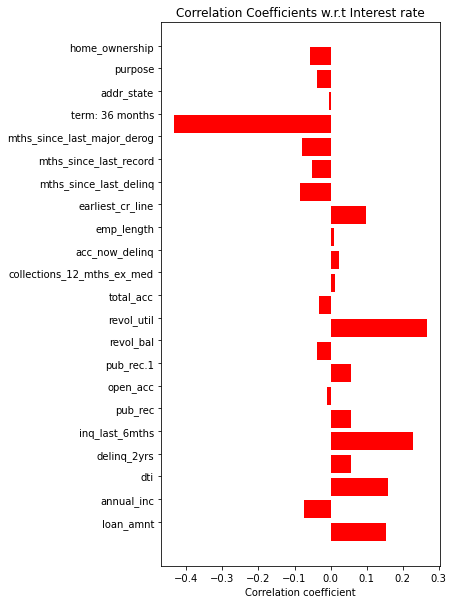

In [37]:
num_feat=loan_data.columns[loan_data.dtypes!=object]
num_feat=num_feat[1:-1] 
labels = []
values = []
for col in num_feat:
    labels.append(col)
    values.append(np.corrcoef(loan_data[col].values, loan_data.int_rate.values)[0,1])
    
ind = np.arange(len(labels))
width = 0.9
fig, ax = plt.subplots(figsize=(5,10))
rects = ax.barh(ind, np.array(values), color='red')
ax.set_yticks(ind+((width)/2.))
ax.set_yticklabels(labels, rotation='horizontal')
ax.set_xlabel("Correlation coefficient")
ax.set_title("Correlation Coefficients w.r.t Interest rate");

In [53]:
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=0)

In [54]:
regressor = LinearRegression()  
LIR=regressor.fit(X_train, y_train) 

In [55]:
y_pred = LIR.predict(X_test)

In [56]:
y_test = np.array(y_test)
y_pred = np.array(y_pred)

In [57]:
df = pd.DataFrame({'Actual': y_test.flatten(), 'Predicted': y_pred.flatten()})
df

,Actual,Predicted
0,0.558513,0.355213
1,0.239544,0.303461
2,0.352767,0.357461
3,0.000000,0.088254
4,0.302915,0.457469
5,0.434728,0.428014
6,0.338403,0.425229
7,0.239544,0.229630
8,0.197296,0.297511
9,0.262357,0.347329


In [58]:
LIR.coef_

array([[ 2.62964115e-02, -2.00850749e+00,  7.27969098e-02,
         1.19840451e-01,  1.54494323e+00,  2.54818305e-05,
         1.20207265e-01,  1.34798883e-02, -1.46817692e+00,
         7.31121016e-01, -2.49813752e-01,  4.28479822e-02,
         2.68022689e-01,  4.66754006e-03,  1.78873995e-01,
        -3.48311095e-02, -3.46455767e-02, -2.03856819e-02,
        -1.61054668e-01, -1.89436925e-04,  8.41933844e-04,
        -1.22486669e-02,  4.16909002e-02]])

In [59]:
from sklearn.metrics import mean_squared_error
rmse = mean_squared_error(y_test, y_pred)
rmse

0.02123523137930264